# 1. Data Expose via API

In the following section, we will retrieve data from the Flask API, which is hosted at the base URL http://127.0.0.1:5000.


In [45]:
import pandas as pd
import numpy as np
import scipy.stats as stats
from datetime import datetime

import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler

import pymysql

from geopy.distance import geodesic
import folium

In [1]:
import requests

def fetch_communiyt_taxi_comapny_location(url):
    response = requests.get(url)
    data = response.json()
    return pd.json_normalize(data)

# Fetch urls for community, taxi, company, location
urls = {
    "community": "http://127.0.0.1:5000/community",
    "taxi": "http://127.0.0.1:5000/taxi",
    "company": "http://127.0.0.1:5000/company",
    "location": "http://127.0.0.1:5000/location"
}


#Fetch trips
def fetch_all_pages(base_url, start_page, end_page):
    all_data_frames = []
    for page in range(start_page, end_page + 1):
        try:
            response = requests.get(f"{base_url}/?page={page}")
            response.raise_for_status()  # Raises an error for non-200 responses
            page_data = response.json()
            page_frame = pd.json_normalize(page_data['data'])
            all_data_frames.append(page_frame)
        except requests.RequestException as e:
            print(f"An error occurred on page {page}: {e}")
            break 
    return pd.concat(all_data_frames, ignore_index=True)

# Usage
base_url = "http://127.0.0.1:5000/trips/4"
start_page = 1
end_page = 95



In [4]:
#featch data
community = fetch_communiyt_taxi_comapny_location(urls["community"])
taxi = fetch_communiyt_taxi_comapny_location(urls["taxi"])
company = fetch_communiyt_taxi_comapny_location(urls["company"])
location = fetch_communiyt_taxi_comapny_location(urls["location"])
all_trips = fetch_all_pages(base_url, start_page, end_page)



# 2. Data cleaning & EDA

In [5]:
trips = all_trips.copy()

In [6]:
display(trips.head())
display(community.head())
display(taxi.head())
display(company.head())
display(location.head())


,company_id,dropoff_community_area,dropoff_latitude,dropoff_location,dropoff_longitude,extras,fare,payment_type,pickup_community_area,pickup_latitude,pickup_location,pickup_longitude,taxi_id,tips,trip_end_timestamp,trip_miles,trip_seconds,trip_start_timestamp,trip_total,unique_key
0,4,32,41.884987,"41.884987192, -87.620992913",-87.620993,1.50,5.45,Credit Card,32,41.880994,"41.880994471, -87.632746489",-87.632746,b19847c6c45cc89f385408086d905e8de9069bd2ac1715...,1.00,"Thu, 19 Mar 2015 15:00:00 GMT",1.0,287.0,"Thu, 19 Mar 2015 15:00:00 GMT",7.95,000008622a94904e7ba554663f7e286fa38c362e
1,4,32,41.877406,"41.877406123, -87.621971652",-87.621972,0.00,6.65,Credit Card,8,41.895033,"41.89503345, -87.619710672",-87.619711,17d9b7691aef7770e5a9e499426b26049100251dbb41dd...,1.00,"Mon, 15 Jun 2015 09:00:00 GMT",1.2,471.0,"Mon, 15 Jun 2015 09:00:00 GMT",7.65,0000282684214e9e541533eae7b74d315dc4cf04
2,4,56,41.792592,"41.79259236, -87.769615453",-87.769615,2.00,34.65,Cash,5,41.947792,"41.947791586, -87.683834942",-87.683835,b5c02d201b243945eb850f84478b473694a0b017009daa...,0.00,"Wed, 15 Apr 2015 08:15:00 GMT",15.4,2785.0,"Wed, 15 Apr 2015 07:30:00 GMT",36.65,0000dc2c3d82d4198dffbbe5b9a1a2b402f2983e
3,4,8,41.892508,"41.892507781, -87.626214906",-87.626215,0.50,6.85,Credit Card,32,41.880994,"41.880994471, -87.632746489",-87.632746,9993904a2f796897a5b465ee4440c2e5cf569afc773e2f...,2.00,"Tue, 11 Aug 2015 08:15:00 GMT",1.0,543.0,"Tue, 11 Aug 2015 08:00:00 GMT",9.35,0000e731269eef2329b63290c3ad5a74b5e06e39
4,4,8,41.893216,"41.89321636, -87.63784421",-87.637844,0.00,5.45,Credit Card,32,41.880994,"41.880994471, -87.632746489",-87.632746,341cead8979074196f3231099ef811c4e905d7031dd6d7...,3.00,"Mon, 12 Oct 2015 08:45:00 GMT",0.9,294.0,"Mon, 12 Oct 2015 08:45:00 GMT",8.45,0000ef5d98a13d470568d323cb46b9cb954aeb4c


,community_name,community_number,population
0,Rogers Park,1,55628
1,West Ridge,2,77122
2,Uptown,3,57182
3,Lincoln Square,4,40494
4,North Center,5,35114


,company_id,public_vehicle_number,taxi_id,vehicle_color,vehicle_fuel_source,vehicle_make,vehicle_model_year
0,None,2590,0041f8f0c91881c1e1913f2548522495fe3c4c719aa67f...,WHITE,Hybrid,FORD,2012
1,None,1704,00f011f177d14242f8a1eb4315abe2f7b82be989761ed1...,WHITE,Hybrid,FORD,2012
2,None,2324,026680639419aa9f5c6a661503df648c66c6621db33fee...,WHITE,Hybrid,TOYOTA,2014
3,None,1668,0300862a19483bcacac6176544abf331b8a3d41ec6efda...,WHITE,Hybrid,TOYOTA,2013
4,None,6537,0309e367d50b97dc7c5d764697737bfac5e6d048f72798...,WHITE,Hybrid,FORD,2012


,address,business_phone,city_state,company,company_id,dispatch_phone,email,taxi_exterior_color,zip
0,9696 W. FOSTER AVE,773-561-4444,"CHICAGO, IL",Flash Cab,1,773-561-4444,info@flash.com,White,60656
1,"3800 N MILWAUKEE AVE, SUITE A",773-907-0200,"CHICAGO, IL",Yellow Cab,2,312-829-4222,None,Yellow,60641
2,2617 S. WABASH AV,312-791-1180,"CHICAGO, IL",Chicago Carriage Cab Corp,3,312-326-2221,None,"Maroon, Blue Stripes",60616
3,"3800 N MILWAUKEE AVE, SUITE A",773-327-6161,"CHICAGO, IL",American United,4,773-248-7600,None,"White, Stars, Stripes",60641
4,2601 W. PETERSON AV,773-907-0050,"CHICAGO, IL",City Service,5,773-907-0909,None,White,60659


,address,location_coordinates
0,"East 130th Street, Philip Murray Homes, Riverd...","41.660136051, -87.60284764"
1,"IDNR Burnham Greenway Trail, Hegewisch, Chicag...","41.663670652, -87.540935513"
2,"12109, South Parnell Avenue, Stewart Ridge, We...","41.673819904, -87.635739777"
3,"11173, South Esmond Street, Morgan Park, Chica...","41.689729914, -87.669054403"
4,"Big Marsh Park, 11555, South Stony Island Aven...","41.690633347, -87.570058269"


In [7]:
display(trips.shape)
display(community.shape)
display(taxi.shape)
display(company.shape)
display(location.shape)


(943890, 20)

(77, 3)

(386, 7)

(19, 9)

(485, 2)

In [8]:
display(trips.info())
display(community.info())
display(taxi.info())
display(company.info())
display(location.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 943890 entries, 0 to 943889
Data columns (total 20 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   company_id              943890 non-null  int64  
 1   dropoff_community_area  943890 non-null  int64  
 2   dropoff_latitude        943890 non-null  object 
 3   dropoff_location        943890 non-null  object 
 4   dropoff_longitude       943890 non-null  object 
 5   extras                  943890 non-null  object 
 6   fare                    943890 non-null  object 
 7   payment_type            943890 non-null  object 
 8   pickup_community_area   943890 non-null  int64  
 9   pickup_latitude         943890 non-null  object 
 10  pickup_location         943890 non-null  object 
 11  pickup_longitude        943890 non-null  object 
 12  taxi_id                 943890 non-null  object 
 13  tips                    943890 non-null  object 
 14  trip_end_timestamp  

None

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 77 entries, 0 to 76
Data columns (total 3 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   community_name    77 non-null     object
 1   community_number  77 non-null     int64 
 2   population        77 non-null     int64 
dtypes: int64(2), object(1)
memory usage: 1.9+ KB


None

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 386 entries, 0 to 385
Data columns (total 7 columns):
 #   Column                 Non-Null Count  Dtype 
---  ------                 --------------  ----- 
 0   company_id             0 non-null      object
 1   public_vehicle_number  386 non-null    int64 
 2   taxi_id                386 non-null    object
 3   vehicle_color          386 non-null    object
 4   vehicle_fuel_source    386 non-null    object
 5   vehicle_make           386 non-null    object
 6   vehicle_model_year     386 non-null    int64 
dtypes: int64(2), object(5)
memory usage: 21.2+ KB


None

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19 entries, 0 to 18
Data columns (total 9 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   address              19 non-null     object
 1   business_phone       19 non-null     object
 2   city_state           19 non-null     object
 3   company              19 non-null     object
 4   company_id           19 non-null     int64 
 5   dispatch_phone       19 non-null     object
 6   email                13 non-null     object
 7   taxi_exterior_color  19 non-null     object
 8   zip                  19 non-null     int64 
dtypes: int64(2), object(7)
memory usage: 1.5+ KB


None

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 485 entries, 0 to 484
Data columns (total 2 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   address               485 non-null    object
 1   location_coordinates  485 non-null    object
dtypes: object(2)
memory usage: 7.7+ KB


None

In [9]:
trips = pd.merge(trips, company, left_on='company_id', right_on='company_id', how='left')
trips = pd.merge(trips, community, left_on='dropoff_community_area', right_on='community_number', how='left')
trips = pd.merge(trips, community, left_on='pickup_community_area', right_on='community_number', how='left')
trips = pd.merge(trips, location, left_on='dropoff_location', right_on='location_coordinates', how='left')
trips = pd.merge(trips, location, left_on='pickup_location', right_on='location_coordinates', how='left')

trips.drop(columns=['population_y', 'community_number_y', 'population_x', 'community_number_x', 'zip', 
                        'dispatch_phone', 'email', 'taxi_exterior_color', 'city_state', 'business_phone',
                   'dropoff_community_area','pickup_community_area', 'address_x','location_coordinates_x','location_coordinates_y'], inplace=True)


trips.rename(columns={'community_name_x': 'dropoff_community_area', 'community_name_y': 'pickup_community_area','address_y': 'dropoff_address','address': 'pickup_address',}, inplace=True)




In [10]:
trips.columns

Index(['company_id', 'dropoff_latitude', 'dropoff_location',
       'dropoff_longitude', 'extras', 'fare', 'payment_type',
       'pickup_latitude', 'pickup_location', 'pickup_longitude', 'taxi_id',
       'tips', 'trip_end_timestamp', 'trip_miles', 'trip_seconds',
       'trip_start_timestamp', 'trip_total', 'unique_key', 'company',
       'dropoff_community_area', 'pickup_community_area', 'dropoff_address',
       'pickup_address'],
      dtype='object')

In [11]:
trips.isnull().sum()

company_id                  0
dropoff_latitude            0
dropoff_location            0
dropoff_longitude           0
extras                      0
fare                        0
payment_type                0
pickup_latitude             0
pickup_location             0
pickup_longitude            0
taxi_id                     0
tips                        0
trip_end_timestamp          0
trip_miles                  0
trip_seconds                0
trip_start_timestamp        0
trip_total                  0
unique_key                  0
company                     0
dropoff_community_area      0
pickup_community_area       0
dropoff_address           107
pickup_address              2
dtype: int64

In [13]:
trips = trips.dropna()

In [14]:
trips.columns

Index(['company_id', 'dropoff_latitude', 'dropoff_location',
       'dropoff_longitude', 'extras', 'fare', 'payment_type',
       'pickup_latitude', 'pickup_location', 'pickup_longitude', 'taxi_id',
       'tips', 'trip_end_timestamp', 'trip_miles', 'trip_seconds',
       'trip_start_timestamp', 'trip_total', 'unique_key', 'company',
       'dropoff_community_area', 'pickup_community_area', 'dropoff_address',
       'pickup_address'],
      dtype='object')

In [15]:
trips = trips[['unique_key','taxi_id','company','trip_start_timestamp','trip_end_timestamp','trip_seconds','trip_miles','trip_total','payment_type','pickup_latitude','pickup_longitude','dropoff_latitude','dropoff_longitude','pickup_community_area','dropoff_community_area','pickup_address','dropoff_address']]

In [16]:
trips.info()

<class 'pandas.core.frame.DataFrame'>
Index: 943781 entries, 0 to 943889
Data columns (total 17 columns):
 #   Column                  Non-Null Count   Dtype  
---  ------                  --------------   -----  
 0   unique_key              943781 non-null  object 
 1   taxi_id                 943781 non-null  object 
 2   company                 943781 non-null  object 
 3   trip_start_timestamp    943781 non-null  object 
 4   trip_end_timestamp      943781 non-null  object 
 5   trip_seconds            943781 non-null  float64
 6   trip_miles              943781 non-null  float64
 7   trip_total              943781 non-null  object 
 8   payment_type            943781 non-null  object 
 9   pickup_latitude         943781 non-null  object 
 10  pickup_longitude        943781 non-null  object 
 11  dropoff_latitude        943781 non-null  object 
 12  dropoff_longitude       943781 non-null  object 
 13  pickup_community_area   943781 non-null  object 
 14  dropoff_community_area  9

In [17]:
trips['trip_start_timestamp'] = pd.to_datetime(trips['trip_start_timestamp'], format='%a, %d %b %Y %H:%M:%S GMT', utc=True)
trips['trip_end_timestamp'] = pd.to_datetime(trips['trip_end_timestamp'], format='%a, %d %b %Y %H:%M:%S GMT', utc=True)
trips['trip_total'] = trips['trip_total'].astype('float64')
trips['pickup_latitude'] = trips['pickup_latitude'].astype('float64')
trips['pickup_longitude'] = trips['pickup_longitude'].astype('float64')
trips['dropoff_latitude'] = trips['dropoff_latitude'].astype('float64')
trips['dropoff_longitude'] = trips['dropoff_longitude'].astype('float64')

In [18]:
trips.info()

<class 'pandas.core.frame.DataFrame'>
Index: 943781 entries, 0 to 943889
Data columns (total 17 columns):
 #   Column                  Non-Null Count   Dtype              
---  ------                  --------------   -----              
 0   unique_key              943781 non-null  object             
 1   taxi_id                 943781 non-null  object             
 2   company                 943781 non-null  object             
 3   trip_start_timestamp    943781 non-null  datetime64[ns, UTC]
 4   trip_end_timestamp      943781 non-null  datetime64[ns, UTC]
 5   trip_seconds            943781 non-null  float64            
 6   trip_miles              943781 non-null  float64            
 7   trip_total              943781 non-null  float64            
 8   payment_type            943781 non-null  object             
 9   pickup_latitude         943781 non-null  float64            
 10  pickup_longitude        943781 non-null  float64            
 11  dropoff_latitude        943781 

In [ ]:
# trips.to_csv('2015_american_united_trips.csv', index=False)

In [ ]:
# trips_sampled = trips.sample(frac=0.01)

In [ ]:
# trips_sampled.to_csv('trips_sampled.csv', index=False)

In [2]:
# import pandas as pd
# trips = pd.read_csv('2015_american_united_trips.csv')


In [19]:
trips.info()

<class 'pandas.core.frame.DataFrame'>
Index: 943781 entries, 0 to 943889
Data columns (total 17 columns):
 #   Column                  Non-Null Count   Dtype              
---  ------                  --------------   -----              
 0   unique_key              943781 non-null  object             
 1   taxi_id                 943781 non-null  object             
 2   company                 943781 non-null  object             
 3   trip_start_timestamp    943781 non-null  datetime64[ns, UTC]
 4   trip_end_timestamp      943781 non-null  datetime64[ns, UTC]
 5   trip_seconds            943781 non-null  float64            
 6   trip_miles              943781 non-null  float64            
 7   trip_total              943781 non-null  float64            
 8   payment_type            943781 non-null  object             
 9   pickup_latitude         943781 non-null  float64            
 10  pickup_longitude        943781 non-null  float64            
 11  dropoff_latitude        943781 

In [20]:
trips['trip_start_timestamp'] = pd.to_datetime(trips['trip_start_timestamp'])
trips['trip_end_timestamp'] = pd.to_datetime(trips['trip_end_timestamp'])

In [21]:
trips_cat = trips.select_dtypes(include=['object'])
trips_num = trips.select_dtypes(include=['float64','int64'])
trips_cat = trips_cat.drop(['unique_key','taxi_id'], axis=1)
trips_num = trips_num.drop(['pickup_latitude','pickup_longitude','dropoff_latitude','dropoff_longitude'], axis=1)

## Categorical Features Exploration

/var/folders/nw/mbbzxf057dj11jnrnf1qcpc40000gn/T/ipykernel_76308/523299781.py:9: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels([label.get_text()[:20] + '...' for label in ax.get_yticklabels()])
/var/folders/nw/mbbzxf057dj11jnrnf1qcpc40000gn/T/ipykernel_76308/523299781.py:9: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels([label.get_text()[:20] + '...' for label in ax.get_yticklabels()])


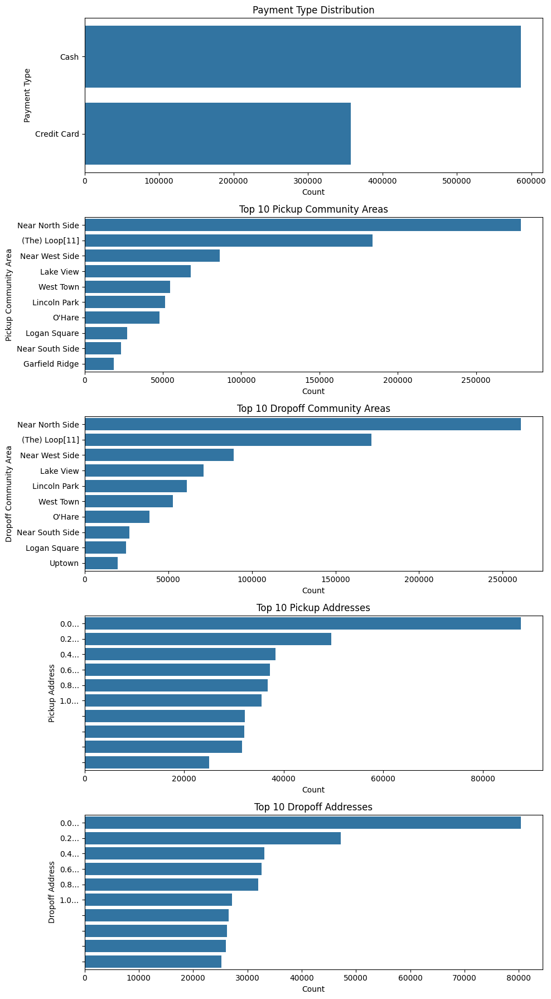

In [22]:
def plot_countplot_short_labels(data, column, ax, title, top_n=None):
    if top_n:
        top_categories = data[column].value_counts().head(top_n).index
        data_top = data[data[column].isin(top_categories)]
    else:
        data_top = data
    
    if 'address' in column:
        ax.set_yticklabels([label.get_text()[:20] + '...' for label in ax.get_yticklabels()])
    
    sns.countplot(y=column, data=data_top, order=data_top[column].value_counts().index, ax=ax)
    ax.set_title(title)
    ax.set_xlabel('Count')
    ax.set_ylabel(column.replace('_', ' ').title())


fig, axs = plt.subplots(5, 1, figsize=(10, 18))


plot_countplot_short_labels(trips, 'payment_type', axs[0], 'Payment Type Distribution')
plot_countplot_short_labels(trips, 'pickup_community_area', axs[1], 'Top 10 Pickup Community Areas', top_n=10)
plot_countplot_short_labels(trips, 'dropoff_community_area', axs[2], 'Top 10 Dropoff Community Areas', top_n=10)

# For pickup and dropoff addresses, apply the modified plotting function
plot_countplot_short_labels(trips, 'pickup_address', axs[3], 'Top 10 Pickup Addresses', top_n=10)
plot_countplot_short_labels(trips, 'dropoff_address', axs[4], 'Top 10 Dropoff Addresses', top_n=10)

plt.tight_layout()
plt.show()


## Numerical Features 

In [23]:
trips_num.describe()

,trip_seconds,trip_miles,trip_total
count,943781.000000,943781.000000,943781.000000
mean,763.032651,3.737795,13.193754
std,710.897550,4.806986,11.290776
min,0.000000,0.000000,0.000000
25%,344.000000,0.900000,6.650000
50%,574.000000,1.800000,9.250000
75%,948.000000,4.100000,14.050000
max,86392.000000,97.600000,488.650000


In [24]:
trips_num_corr = trips_num.corr()
trips_num_corr

,trip_seconds,trip_miles,trip_total
trip_seconds,1.000000,0.776431,0.822168
trip_miles,0.776431,1.000000,0.946807
trip_total,0.822168,0.946807,1.000000


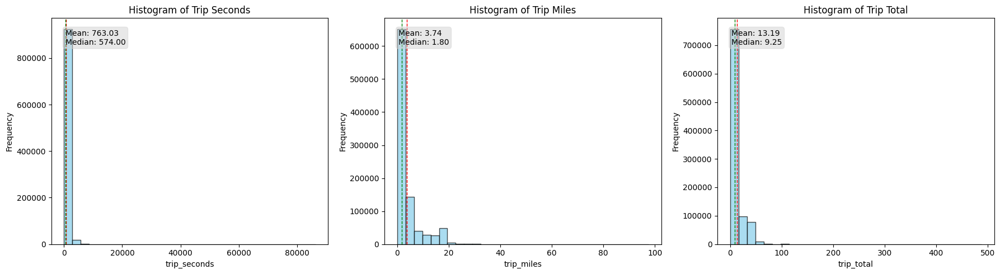

In [25]:

def plot_histogram_with_labels(data, column, ax, title):
    values = data[column].dropna()  # Remove NaN values
    mean_val = values.mean()
    median_val = values.median()
    

    ax.hist(values, bins=30, color='skyblue', alpha=0.7, edgecolor='black')
    ax.axvline(mean_val, color='red', linestyle='dashed', linewidth=1)
    ax.axvline(median_val, color='green', linestyle='dashed', linewidth=1)


    label_text = f'Mean: {mean_val:.2f}\nMedian: {median_val:.2f}'
    ax.text(0.05, 0.95, label_text, transform=ax.transAxes, fontsize=10,
            verticalalignment='top', bbox=dict(boxstyle="round", alpha=0.5, color='lightgrey'))

    ax.set_title(title)
    ax.set_xlabel(column)
    ax.set_ylabel('Frequency')

fig, axs = plt.subplots(1, 3, figsize=(18, 5))


plot_histogram_with_labels(trips, 'trip_seconds', axs[0], 'Histogram of Trip Seconds')
plot_histogram_with_labels(trips, 'trip_miles', axs[1], 'Histogram of Trip Miles')
plot_histogram_with_labels(trips, 'trip_total', axs[2], 'Histogram of Trip Total')

plt.tight_layout()
plt.show()


### Average Turnaround time (time diff between one droppoff time to the next pickup time)

In [26]:
# To calculate the average time difference between one dropoff to the next pickup for the same taxi,
# we first need to sort the data by taxi_id and trip_end_timestamp to ensure chronological order of trips for each taxi.
data_sorted = trips.sort_values(by=['taxi_id', 'trip_end_timestamp'])


data_sorted['trip_start_timestamp'] = pd.to_datetime(data_sorted['trip_start_timestamp'])
data_sorted['trip_end_timestamp'] = pd.to_datetime(data_sorted['trip_end_timestamp'])

# Calculate the time difference between the current trip's start and the previous trip's end for the same taxi
data_sorted['time_diff'] = data_sorted.groupby('taxi_id')['trip_start_timestamp'].diff() - data_sorted.groupby('taxi_id')['trip_end_timestamp'].shift().diff()

# Calculate the average of these time differences
average_time_diff = data_sorted['time_diff'].mean()

average_time_diff

Timedelta('0 days 00:00:13.676608086')

### Avaerage Daily Earnings per Taxi

In [27]:
# To calculate the daily average earning per taxi, we first extract the date from trip_start_timestamp
data_sorted['date'] = data_sorted['trip_start_timestamp'].dt.date
daily_earnings = data_sorted.groupby(['taxi_id', 'date'])['trip_total'].sum().reset_index()

# Calculate the daily average earning per taxi across all dates
average_daily_earning = daily_earnings['trip_total'].mean()

# Find the maximum and minimum daily earning across all taxis and dates
max_daily_earning = daily_earnings['trip_total'].max()
min_daily_earning = daily_earnings['trip_total'].min()

average_daily_earning, max_daily_earning, min_daily_earning


(223.67950295496593, 1491.95, 2.4)

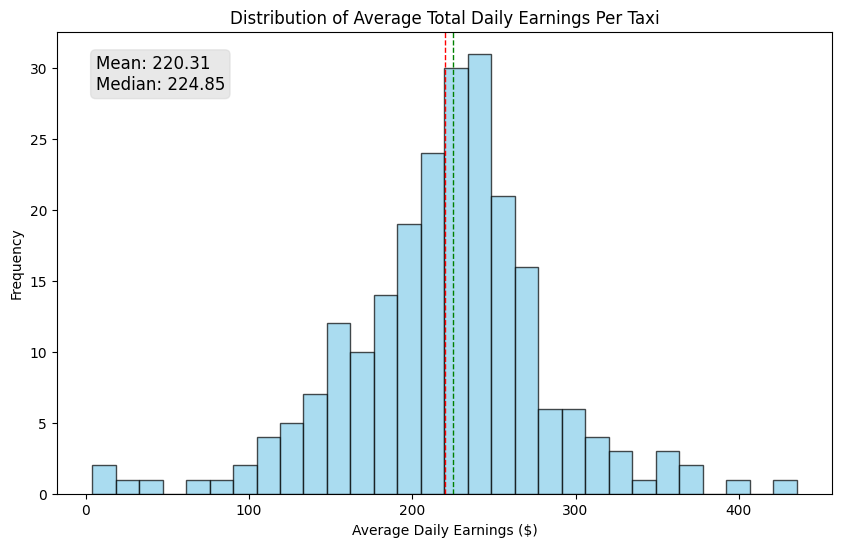

In [28]:
# Calculate the average total daily earnings per taxi across all dates
average_daily_earnings_per_taxi = daily_earnings.groupby('taxi_id')['trip_total'].mean().reset_index()


fig, ax = plt.subplots(figsize=(10, 6))
values = average_daily_earnings_per_taxi['trip_total']
mean_val = values.mean()
median_val = values.median()


ax.hist(values, bins=30, color='skyblue', alpha=0.7, edgecolor='black')
ax.axvline(mean_val, color='red', linestyle='dashed', linewidth=1)
ax.axvline(median_val, color='green', linestyle='dashed', linewidth=1)


label_text = f'Mean: {mean_val:.2f}\nMedian: {median_val:.2f}'
ax.text(0.05, 0.95, label_text, transform=ax.transAxes, fontsize=12,
        verticalalignment='top', bbox=dict(boxstyle="round", alpha=0.5, color='lightgrey'))

ax.set_title('Distribution of Average Total Daily Earnings Per Taxi')
ax.set_xlabel('Average Daily Earnings ($)')
ax.set_ylabel('Frequency')

plt.show()


In [29]:
import folium
from folium.plugins import HeatMap

# Extract the pickup latitude and longitude
pickup_locations = trips[['pickup_latitude', 'pickup_longitude']].dropna()

# Calculate the mean of pickup locations to center the map
mean_lat = pickup_locations['pickup_latitude'].mean()
mean_long = pickup_locations['pickup_longitude'].mean()


map = folium.Map(location=[mean_lat, mean_long], zoom_start=11)

# Add a heat map layer for pickup locations
HeatMap(data=pickup_locations, radius=10).add_to(map)

map


In [30]:
# Group by taxi_id and aggregate the required metrics
aggregated_taxi = trips.groupby('taxi_id').agg(
    trips_count=pd.NamedAgg(column='unique_key', aggfunc='count'),
    total_trip_total=pd.NamedAgg(column='trip_total', aggfunc='sum'),
    total_trip_seconds=pd.NamedAgg(column='trip_seconds', aggfunc='sum'),
    total_trip_miles=pd.NamedAgg(column='trip_miles', aggfunc='sum')
).reset_index()

aggregated_taxi.head()


,taxi_id,trips_count,total_trip_total,total_trip_seconds,total_trip_miles
0,0041f8f0c91881c1e1913f2548522495fe3c4c719aa67f...,2913,39178.27,2202348.0,10998.4
1,026680639419aa9f5c6a661503df648c66c6621db33fee...,2640,30574.61,1879561.0,8432.6
2,0300862a19483bcacac6176544abf331b8a3d41ec6efda...,4876,55647.65,3615213.0,16032.7
3,0309e367d50b97dc7c5d764697737bfac5e6d048f72798...,2140,25117.33,1511325.0,6681.1
4,03cc788ae35f829575456d05381274aab1700ba7b0ea78...,5539,74161.11,4446724.0,21127.1


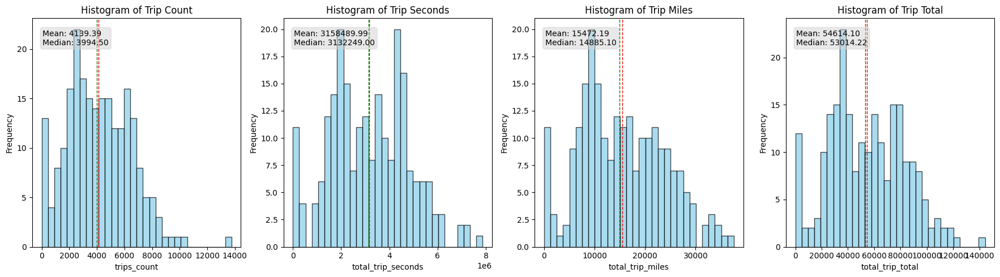

In [31]:

fig, axs = plt.subplots(1, 4, figsize=(18, 5))

# Plot histograms with modified label presentation
plot_histogram_with_labels(aggregated_taxi, 'trips_count', axs[0], 'Histogram of Trip Count')
plot_histogram_with_labels(aggregated_taxi, 'total_trip_seconds', axs[1], 'Histogram of Trip Seconds')
plot_histogram_with_labels(aggregated_taxi, 'total_trip_miles', axs[2], 'Histogram of Trip Miles')
plot_histogram_with_labels(aggregated_taxi, 'total_trip_total', axs[3], 'Histogram of Trip Total')

plt.tight_layout()
plt.show()


In [32]:
aggregated_taxi.describe()

,trips_count,total_trip_total,total_trip_seconds,total_trip_miles
count,228.000000,228.000000,2.280000e+02,228.000000
mean,4139.390351,54614.097588,3.158490e+06,15472.191667
std,2308.966035,28743.474344,1.632463e+06,8308.895995
min,1.000000,3.900000,9.000000e+00,0.000000
25%,2464.250000,33302.740000,1.904444e+06,9274.525000
50%,3994.500000,53014.225000,3.132249e+06,14885.100000
75%,5858.250000,76666.005000,4.397398e+06,21620.850000
max,13756.000000,144184.500000,7.867756e+06,37575.900000


### Segment Analysis: Divided into Four Different Groups by Total Annual Earnings
- Top 25%
- 50-75th Percentile
- 25-50th Percentile
- Bottom 25%

In [33]:
quartiles = aggregated_taxi['total_trip_total'].quantile([0.25, 0.5, 0.75]).values

# Filter the DataFrame based on these quartiles
# Top 25%
top_25 = aggregated_taxi[aggregated_taxi['total_trip_total'] > quartiles[2]]

# Top 25-50%
top_25_50 = aggregated_taxi[(aggregated_taxi['total_trip_total'] > quartiles[1]) & (aggregated_taxi['total_trip_total'] <= quartiles[2])]

# Top 50-75%
top_50_75 = aggregated_taxi[(aggregated_taxi['total_trip_total'] > quartiles[0]) & (aggregated_taxi['total_trip_total'] <= quartiles[1])]

# Bottom 25% (75%-100%)
bottom_25 = aggregated_taxi[aggregated_taxi['total_trip_total'] <= quartiles[0]]

# Count the number of entries in each quartile
quartile_counts = {
    'top_25_count': top_25.shape[0],
    'top_25_50_count': top_25_50.shape[0],
    'top_50_75_count': top_50_75.shape[0],
    'bottom_25_count': bottom_25.shape[0]
}

quartile_counts


{'top_25_count': 57,
 'top_25_50_count': 57,
 'top_50_75_count': 57,
 'bottom_25_count': 57}

'Top 25'

,trips_count,total_trip_total,total_trip_seconds,total_trip_miles
count,57.000000,57.000000,5.700000e+01,57.000000
mean,6897.526316,91939.934211,5.202491e+06,26325.954386
std,1624.013152,13451.498829,8.265516e+05,4096.746529
min,4066.000000,76971.810000,4.221224e+06,19506.300000
25%,6104.000000,81509.550000,4.541101e+06,22994.900000
50%,6723.000000,89362.520000,4.991882e+06,25428.300000
75%,7591.000000,97585.370000,5.643547e+06,28497.500000
max,13756.000000,144184.500000,7.867756e+06,37575.900000


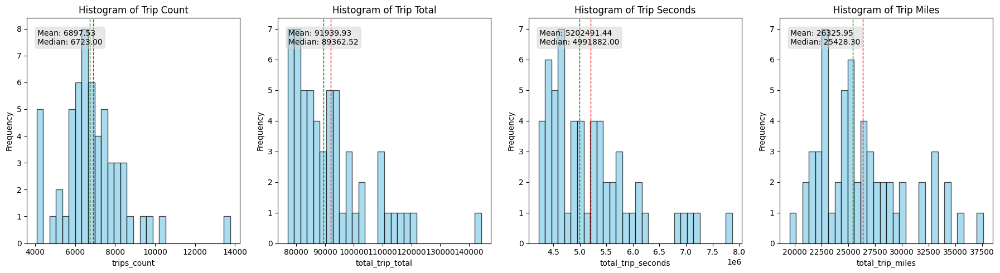

In [34]:
display('Top 25',top_25.describe())

fig, axs = plt.subplots(1, 4, figsize=(18, 5))

# Plot histograms with modified label presentation
plot_histogram_with_labels(top_25, 'trips_count', axs[0], 'Histogram of Trip Count')
plot_histogram_with_labels(top_25, 'total_trip_total', axs[1], 'Histogram of Trip Total')
plot_histogram_with_labels(top_25, 'total_trip_seconds', axs[2], 'Histogram of Trip Seconds')
plot_histogram_with_labels(top_25, 'total_trip_miles', axs[3], 'Histogram of Trip Miles')



plt.tight_layout()
plt.show()

'Top 25-50'

,trips_count,total_trip_total,total_trip_seconds,total_trip_miles
count,57.000000,57.000000,5.700000e+01,57.000000
mean,5041.192982,65508.025088,3.827968e+06,18277.121053
std,928.168366,7139.085472,4.567085e+05,2739.786414
min,2410.000000,53389.360000,2.884249e+06,13183.100000
25%,4407.000000,60022.960000,3.495875e+06,16202.500000
50%,5034.000000,64326.590000,3.722585e+06,17974.300000
75%,5617.000000,72891.370000,4.228252e+06,20086.400000
max,7224.000000,76564.070000,4.758225e+06,26721.100000


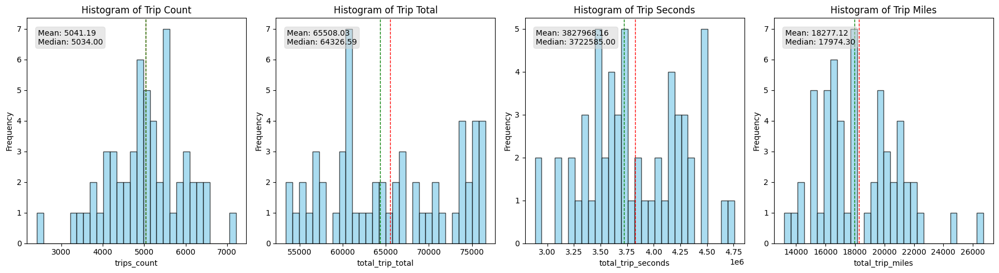

In [35]:
display('Top 25-50',top_25_50.describe())
fig, axs = plt.subplots(1, 4, figsize=(18, 5))

# Plot histograms with modified label presentation
plot_histogram_with_labels(top_25_50, 'trips_count', axs[0], 'Histogram of Trip Count')
plot_histogram_with_labels(top_25_50, 'total_trip_total', axs[1], 'Histogram of Trip Total')
plot_histogram_with_labels(top_25_50, 'total_trip_seconds', axs[2], 'Histogram of Trip Seconds')
plot_histogram_with_labels(top_25_50, 'total_trip_miles', axs[3], 'Histogram of Trip Miles')

plt.tight_layout()
plt.show()

'Top 50-75'

,trips_count,total_trip_total,total_trip_seconds,total_trip_miles
count,57.000000,57.000000,5.700000e+01,57.000000
mean,3155.877193,41183.077544,2.446388e+06,11589.268421
std,670.476591,6140.602141,4.127351e+05,2109.067813
min,2100.000000,33309.140000,1.789836e+06,8219.300000
25%,2655.000000,35221.060000,2.085722e+06,9811.700000
50%,3076.000000,39648.590000,2.348900e+06,11099.600000
75%,3489.000000,46308.290000,2.765830e+06,13168.500000
max,4986.000000,52639.090000,3.299053e+06,17528.900000


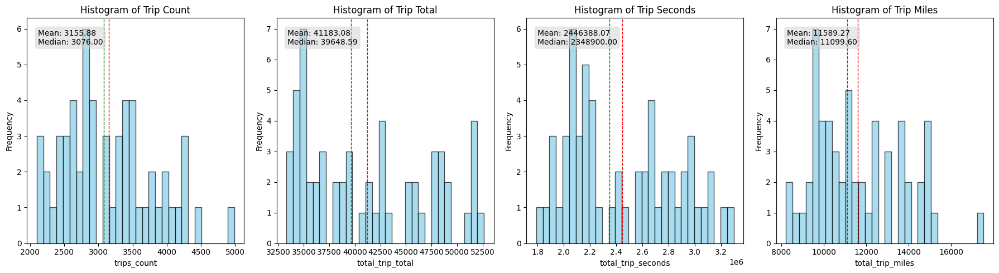

In [36]:
display('Top 50-75',top_50_75.describe())
fig, axs = plt.subplots(1, 4, figsize=(18, 5))

# Plot histograms with modified label presentation
plot_histogram_with_labels(top_50_75, 'trips_count', axs[0], 'Histogram of Trip Count')
plot_histogram_with_labels(top_50_75, 'total_trip_total', axs[1], 'Histogram of Trip Total')
plot_histogram_with_labels(top_50_75, 'total_trip_seconds', axs[2], 'Histogram of Trip Seconds')
plot_histogram_with_labels(top_50_75, 'total_trip_miles', axs[3], 'Histogram of Trip Miles')

plt.tight_layout()
plt.show()

'Bottom 25'

,trips_count,total_trip_total,total_trip_seconds,total_trip_miles
count,57.000000,57.000000,5.700000e+01,57.000000
mean,1462.964912,19825.353509,1.157112e+06,5696.422807
std,903.205580,11181.101970,6.621511e+05,3252.243314
min,1.000000,3.900000,9.000000e+00,0.000000
25%,726.000000,10327.990000,5.171270e+05,2636.400000
50%,1638.000000,23749.100000,1.390910e+06,6571.300000
75%,2161.000000,28483.590000,1.682749e+06,7884.700000
max,2939.000000,33283.540000,2.167183e+06,11419.200000


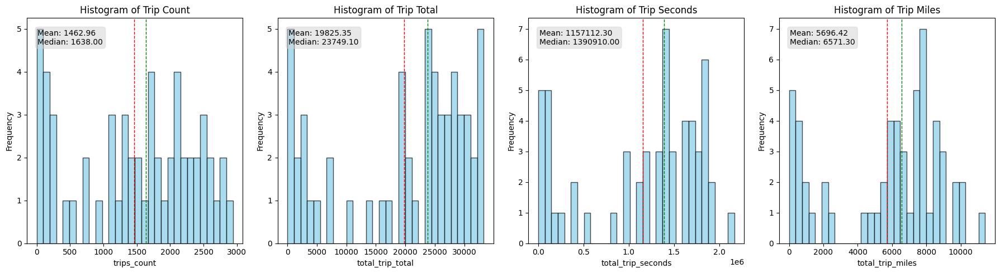

In [37]:
display('Bottom 25',bottom_25.describe())
fig, axs = plt.subplots(1, 4, figsize=(18, 5))

# Plot histograms with modified label presentation
plot_histogram_with_labels(bottom_25, 'trips_count', axs[0], 'Histogram of Trip Count')
plot_histogram_with_labels(bottom_25, 'total_trip_total', axs[1], 'Histogram of Trip Total')
plot_histogram_with_labels(bottom_25, 'total_trip_seconds', axs[2], 'Histogram of Trip Seconds')
plot_histogram_with_labels(bottom_25, 'total_trip_miles', axs[3], 'Histogram of Trip Miles')

plt.tight_layout()
plt.show()

In [38]:
# create extra column - earning-grade,which classified based on the earning
top_25['earning_grade'] = 4
top_25_50['earning_grade'] = 3
top_50_75['earning_grade'] = 2
bottom_25['earning_grade'] = 1
# concat them into a single dataframe
taxi_grade = pd.concat([top_25, top_25_50, top_50_75, bottom_25], axis=0, ignore_index=True)
taxi_grade = taxi_grade[['taxi_id','earning_grade']].reset_index(drop=True)

/var/folders/nw/mbbzxf057dj11jnrnf1qcpc40000gn/T/ipykernel_76308/1991146393.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_25['earning_grade'] = 4
/var/folders/nw/mbbzxf057dj11jnrnf1qcpc40000gn/T/ipykernel_76308/1991146393.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_25_50['earning_grade'] = 3
/var/folders/nw/mbbzxf057dj11jnrnf1qcpc40000gn/T/ipykernel_76308/1991146393.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_inde

In [39]:
#merged taxi_grade to trips dataframe
trips = pd.merge(trips, taxi_grade, on='taxi_id', how='left')

### Comparison of Turnaround Times Between Earning Grades (1 to 4)
- **Turnaround Time**: Defined as the length of time between the last drop-off and the next pickup. This metric serves as an indicator of how efficiently taxi drivers find passengers.

In [40]:
# calculate average turaround time per day per taxi

trips['trip_start_timestamp'] = pd.to_datetime(trips['trip_start_timestamp'])
trips['trip_end_timestamp'] = pd.to_datetime(trips['trip_end_timestamp'])

# Sort the dataframe by taxi_id and trip_start_timestamp to ensure sequential trips are in order
trips = trips.sort_values(by=['taxi_id', 'trip_start_timestamp'])

# Calculate turnaround time as the difference between the current trip's start time and the previous trip's end time
trips['next_pickup_time'] = trips.groupby('taxi_id')['trip_start_timestamp'].shift(-1)
trips['turnaround_time'] = (trips['next_pickup_time'] - trips['trip_end_timestamp']).dt.total_seconds()

# Remove the last trip of each taxi because it does not have a next pickup time
trips = trips[~trips['turnaround_time'].isna()]

# Extract date from trip_start_timestamp to group by day
trips['date'] = trips['trip_start_timestamp'].dt.date

# Calculate average turnaround time per day per taxi
average_turnaround_time_per_day_per_taxi = trips.groupby(['taxi_id', 'date'])['turnaround_time'].mean().reset_index()

average_turnaround_time_per_day_per_taxi.rename(columns={'turnaround_time': 'average_turnaround_time'}, inplace=True)

average_turnaround_time_per_day_per_taxi = average_turnaround_time_per_day_per_taxi.groupby(['taxi_id'])['average_turnaround_time'].mean().reset_index()



In [41]:
average_turnaround_time_per_day_per_taxi = pd.merge(average_turnaround_time_per_day_per_taxi, taxi_grade, on='taxi_id', how='left')

In [67]:
average_turnaround_time_per_day_per_taxi.head()

,taxi_id,average_turnaround_time,earning_grade
0,0041f8f0c91881c1e1913f2548522495fe3c4c719aa67f...,6993.612037,2
1,026680639419aa9f5c6a661503df648c66c6621db33fee...,2250.344628,1
2,0300862a19483bcacac6176544abf331b8a3d41ec6efda...,7361.728509,3
3,0309e367d50b97dc7c5d764697737bfac5e6d048f72798...,16836.648081,1
4,03cc788ae35f829575456d05381274aab1700ba7b0ea78...,9288.958523,3


/var/folders/nw/mbbzxf057dj11jnrnf1qcpc40000gn/T/ipykernel_76308/3005296529.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(average_turnaround_time_per_day_per_taxi[average_turnaround_time_per_day_per_taxi['earning_grade'] == grade]['average_turnaround_time'], kde=True, bins=20)
/var/folders/nw/mbbzxf057dj11jnrnf1qcpc40000gn/T/ipykernel_76308/3005296529.py:6: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to

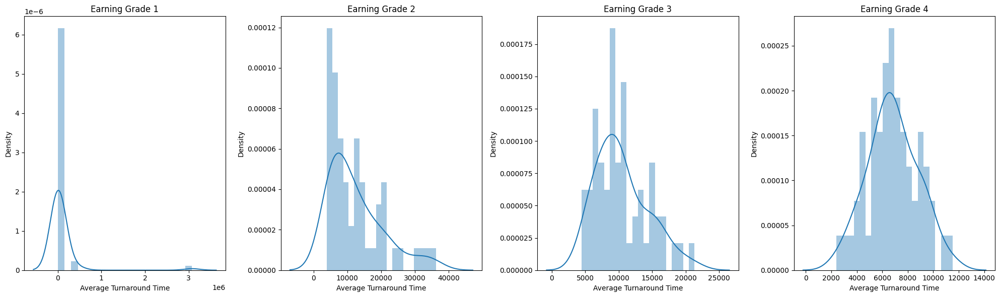

In [43]:
plt.figure(figsize=(20, 6))

# Create a distplot for each earning grade
for i, grade in enumerate(sorted(average_turnaround_time_per_day_per_taxi['earning_grade'].unique()), 1):
    plt.subplot(1, len(average_turnaround_time_per_day_per_taxi['earning_grade'].unique()), i)
    sns.distplot(average_turnaround_time_per_day_per_taxi[average_turnaround_time_per_day_per_taxi['earning_grade'] == grade]['average_turnaround_time'], kde=True, bins=20)
    plt.title(f'Earning Grade {grade}')
    plt.xlabel('Average Turnaround Time')
    plt.ylabel('Density')

plt.tight_layout()
plt.show()

In [57]:
# Conduct an ANOVA test to see if there is a significant difference between grades when it comes to the length of turnaround times."

anova_result = stats.f_oneway(
    average_turnaround_time_per_day_per_taxi[average_turnaround_time_per_day_per_taxi['earning_grade'] == 1]['average_turnaround_time'],
    average_turnaround_time_per_day_per_taxi[average_turnaround_time_per_day_per_taxi['earning_grade'] == 2]['average_turnaround_time'],
    average_turnaround_time_per_day_per_taxi[average_turnaround_time_per_day_per_taxi['earning_grade'] == 3]['average_turnaround_time'],
    average_turnaround_time_per_day_per_taxi[average_turnaround_time_per_day_per_taxi['earning_grade'] == 4]['average_turnaround_time']
)

anova_result

# High pvalue: Fail to reject null hypothesis (no significant differece betwee the group means) > not sufficient data (only 277)

F_onewayResult(statistic=1.9036869845471875, pvalue=0.12983886448141466)

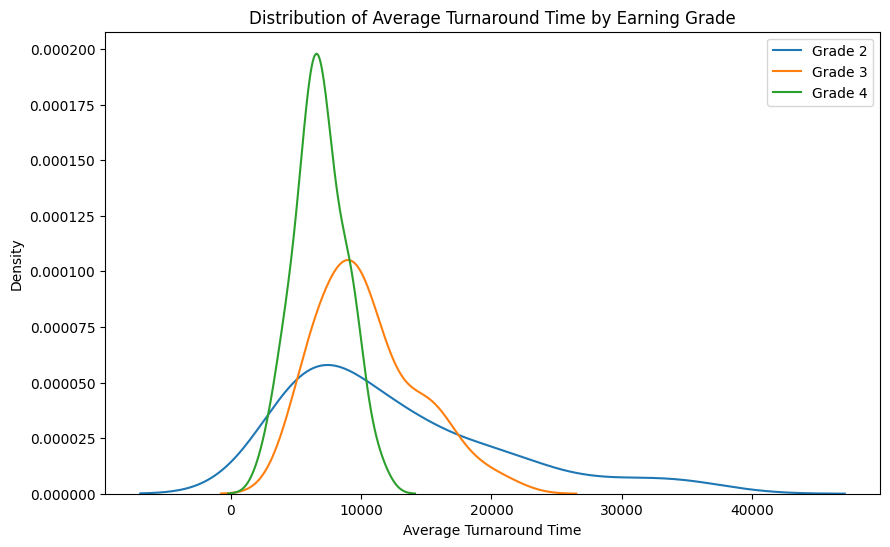

In [73]:
# Setting up the plot with specified figure size
fig, ax = plt.subplots(figsize=(10, 6))

# Plotting kdeplot for all earning grades
# sns.kdeplot(average_turnaround_time_per_day_per_taxi[average_turnaround_time_per_day_per_taxi['earning_grade'] == 1]['average_turnaround_time'], ax=ax, label='Grade 1')
sns.kdeplot(average_turnaround_time_per_day_per_taxi[average_turnaround_time_per_day_per_taxi['earning_grade'] == 2]['average_turnaround_time'], ax=ax, label='Grade 2')
sns.kdeplot(average_turnaround_time_per_day_per_taxi[average_turnaround_time_per_day_per_taxi['earning_grade'] == 3]['average_turnaround_time'], ax=ax, label='Grade 3')
sns.kdeplot(average_turnaround_time_per_day_per_taxi[average_turnaround_time_per_day_per_taxi['earning_grade'] == 4]['average_turnaround_time'], ax=ax, label='Grade 4')

plt.title('Distribution of Average Turnaround Time by Earning Grade')
plt.xlabel('Average Turnaround Time')
plt.ylabel('Density')
plt.legend()

plt.show()


In [59]:
grade_1 = average_turnaround_time_per_day_per_taxi[average_turnaround_time_per_day_per_taxi['earning_grade'] == 1].describe()
grade_2 = average_turnaround_time_per_day_per_taxi[average_turnaround_time_per_day_per_taxi['earning_grade'] == 2].describe()
grade_3 = average_turnaround_time_per_day_per_taxi[average_turnaround_time_per_day_per_taxi['earning_grade'] == 3].describe()
grade_4 = average_turnaround_time_per_day_per_taxi[average_turnaround_time_per_day_per_taxi['earning_grade'] == 4].describe()


In [60]:
display(grade_1)
display(grade_2)
display(grade_3)
display(grade_4)

,average_turnaround_time,earning_grade
count,5.600000e+01,56.0
mean,8.564115e+04,1.0
std,4.150371e+05,0.0
min,9.972973e+02,1.0
25%,7.148007e+03,1.0
50%,1.263232e+04,1.0
75%,2.113293e+04,1.0
max,3.074370e+06,1.0


,average_turnaround_time,earning_grade
count,57.000000,57.0
mean,12499.514669,2.0
std,8163.416737,0.0
min,3942.067036,2.0
25%,6086.004423,2.0
50%,9741.651066,2.0
75%,15676.610344,2.0
max,36226.917862,2.0


,average_turnaround_time,earning_grade
count,57.000000,57.0
mean,10457.348769,3.0
std,3897.674964,0.0
min,4434.023690,3.0
25%,7438.379612,3.0
50%,9591.324934,3.0
75%,12989.017752,3.0
max,21303.706221,3.0


,average_turnaround_time,earning_grade
count,57.000000,57.0
mean,6831.476425,4.0
std,1956.035844,0.0
min,2400.589168,4.0
25%,5517.926474,4.0
50%,6728.304400,4.0
75%,8119.445206,4.0
max,11516.880434,4.0


In [61]:
display(trips[trips['earning_grade'] == 1].describe())
display(trips[trips['earning_grade'] == 2].describe())
display(trips[trips['earning_grade'] == 3].describe())
display(trips[trips['earning_grade'] == 4].describe())


,trip_seconds,trip_miles,trip_total,pickup_latitude,pickup_longitude,dropoff_latitude,dropoff_longitude,earning_grade,turnaround_time
count,83332.000000,83332.000000,83332.000000,83332.000000,83332.000000,83332.000000,83332.000000,83332.0,8.333200e+04
mean,790.856910,3.892305,13.548229,41.900987,-87.662328,41.902311,-87.656161,1.0,8.527622e+03
std,797.327807,4.926481,11.544779,0.040468,0.070217,0.038932,0.057803,0.0,1.083827e+05
min,0.000000,0.000000,2.250000,41.689730,-87.913625,41.660136,-87.913625,1.0,-5.400000e+03
25%,353.000000,1.000000,6.850000,41.880994,-87.663518,41.880994,-87.659864,1.0,0.000000e+00
50%,590.000000,1.900000,9.450000,41.893216,-87.635760,41.893216,-87.637844,1.0,9.000000e+02
75%,989.000000,4.300000,14.580000,41.922686,-87.626215,41.922686,-87.626215,1.0,2.700000e+03
max,86392.000000,45.300000,488.650000,42.016046,-87.551428,42.016046,-87.534903,1.0,1.495710e+07


,trip_seconds,trip_miles,trip_total,pickup_latitude,pickup_longitude,dropoff_latitude,dropoff_longitude,earning_grade,turnaround_time
count,179828.000000,179828.000000,179828.000000,179828.000000,179828.000000,179828.000000,179828.000000,179828.0,1.798280e+05
mean,775.194803,3.672129,13.049422,41.903089,-87.661100,41.903112,-87.655821,2.0,6.229097e+03
std,720.947760,4.747639,10.918684,0.037766,0.067135,0.038582,0.055909,0.0,4.900112e+04
min,0.000000,0.000000,3.250000,41.663671,-87.913625,41.660136,-87.913625,2.0,-8.100000e+03
25%,351.000000,0.900000,6.750000,41.880994,-87.663416,41.880994,-87.659864,2.0,0.000000e+00
50%,578.000000,1.800000,9.250000,41.892658,-87.633308,41.893216,-87.637844,2.0,9.000000e+02
75%,952.000000,3.900000,13.850000,41.922686,-87.626215,41.922686,-87.626215,2.0,1.800000e+03
max,54106.000000,70.600000,317.650000,42.015934,-87.534903,42.021224,-87.534903,2.0,1.373670e+07


,trip_seconds,trip_miles,trip_total,pickup_latitude,pickup_longitude,dropoff_latitude,dropoff_longitude,earning_grade,turnaround_time
count,287291.000000,287291.000000,287291.000000,287291.000000,287291.000000,287291.000000,287291.000000,287291.0,2.872910e+05
mean,759.336603,3.625462,12.994416,41.903670,-87.660130,41.904452,-87.658048,3.0,5.243079e+03
std,710.351028,4.674328,11.173823,0.037561,0.064148,0.038676,0.059775,0.0,3.891478e+04
min,0.000000,0.000000,0.000000,41.663671,-87.913625,41.663671,-87.913625,3.0,-9.900000e+03
25%,343.000000,0.900000,6.650000,41.880994,-87.663416,41.880994,-87.663416,3.0,0.000000e+00
50%,574.000000,1.800000,9.250000,41.893216,-87.635760,41.895033,-87.637844,3.0,9.000000e+02
75%,943.000000,3.900000,13.850000,41.922686,-87.626215,41.922761,-87.626215,3.0,1.800000e+03
max,81822.000000,97.600000,473.250000,42.016046,-87.534903,42.021224,-87.534903,3.0,9.358200e+06


,trip_seconds,trip_miles,trip_total,pickup_latitude,pickup_longitude,dropoff_latitude,dropoff_longitude,earning_grade,turnaround_time
count,393102.000000,393102.000000,393102.000000,393102.000000,393102.000000,393102.000000,393102.000000,393102.0,3.931020e+05
mean,754.255890,3.816704,13.329425,41.904861,-87.661558,41.905101,-87.661437,4.0,3.762823e+03
std,686.563272,4.900001,11.482094,0.037746,0.064150,0.040143,0.063690,0.0,1.578558e+04
min,0.000000,0.000000,2.400000,41.663671,-87.913625,41.660136,-87.913625,4.0,-9.000000e+03
25%,339.000000,0.900000,6.650000,41.880994,-87.663518,41.880994,-87.663518,4.0,0.000000e+00
50%,569.000000,1.800000,9.250000,41.895033,-87.637844,41.895033,-87.638575,4.0,9.000000e+02
75%,943.000000,4.200000,14.220000,41.922761,-87.626215,41.927261,-87.626215,4.0,1.800000e+03
max,37365.000000,92.100000,273.650000,42.016046,-87.534903,42.021224,-87.534903,4.0,2.367000e+06


# Modeling Process
- **Feature Engineering**: Extracts time-related features from trip_start_timestamp.
- **Counting Pickups**: Groups the data by pickup latitude and longitude to count pickups at each location.
- **Clustering**: Applies KMeans clustering to identify popular areas.
- **Cluster Centers**: Calculates the center of each cluster for the Nearest Neighbors model.
- **Nearest Neighbors Model**: Trains the model to find the nearest clusters based on a given location.
- **Recommendation Function**: Takes current location, time, and date, and recommends top 5 pickup locations based on historical popularity and proximity.

In [74]:
# Feature Engineering
trips['trip_start_timestamp'] = pd.to_datetime(trips['trip_start_timestamp'])
trips['weekday'] = trips['trip_start_timestamp'].dt.weekday
trips['hour'] = trips['trip_start_timestamp'].dt.hour

In [75]:
trips.head()

,unique_key,taxi_id,company,trip_start_timestamp,trip_end_timestamp,trip_seconds,trip_miles,trip_total,payment_type,pickup_latitude,...,pickup_community_area,dropoff_community_area,pickup_address,dropoff_address,earning_grade,next_pickup_time,turnaround_time,date,weekday,hour
338114,5bbbb0bb7e43a5cd7f0e61426510ba6d5550544e,0041f8f0c91881c1e1913f2548522495fe3c4c719aa67f...,American United,2015-01-01 00:15:00+00:00,2015-01-01 00:30:00+00:00,635.0,3.4,11.25,Cash,41.906026,...,West Town,Near North Side,"1935, West Evergreen Avenue, Wicker Park, West...","Rush-Ohio-Wabash Self Park, 50, East Ohio Stre...",2,2015-01-01 00:45:00+00:00,900.0,2015-01-01,3,0
13499,03aa74d5bb26cff396ae9c280cb58599722c7b6c,0041f8f0c91881c1e1913f2548522495fe3c4c719aa67f...,American United,2015-01-01 00:45:00+00:00,2015-01-01 00:45:00+00:00,577.0,0.7,7.65,Credit Card,41.895033,...,Near North Side,Near North Side,"Northwestern University Chicago Campus, East C...","Oak Club, 123-127, West Oak Street, Gold Coast...",2,2015-01-01 00:45:00+00:00,0.0,2015-01-01,3,0
687220,ba5073c0b2d01aed750a0e31f9d983ab967bc770,0041f8f0c91881c1e1913f2548522495fe3c4c719aa67f...,American United,2015-01-01 00:45:00+00:00,2015-01-01 01:00:00+00:00,497.0,0.8,7.25,Credit Card,41.899156,...,Near North Side,Near North Side,"The Bristol, 57, East Delaware Place, Magnific...","350-372, West Ontario Street, Near North Side,...",2,2015-01-01 01:00:00+00:00,0.0,2015-01-01,3,0
742542,c9714bb197affae8ff70c4b287ec99f5a94ddbf1,0041f8f0c91881c1e1913f2548522495fe3c4c719aa67f...,American United,2015-01-01 01:00:00+00:00,2015-01-01 01:15:00+00:00,559.0,1.2,8.65,Cash,41.893216,...,Near North Side,(The) Loop[11],"350-372, West Ontario Street, Near North Side,...","Northern Trust Bank, 50, West Arcade Place, Lo...",2,2015-01-01 01:15:00+00:00,0.0,2015-01-01,3,1
696341,bcd1e17c1f42a92f0fe1dbbd76e00f86807c2bdf,0041f8f0c91881c1e1913f2548522495fe3c4c719aa67f...,American United,2015-01-01 01:15:00+00:00,2015-01-01 01:30:00+00:00,916.0,4.5,15.24,Credit Card,41.892042,...,Near North Side,Lake View,"Best Western Plus River North, 125, West Ohio ...","3130, North Lake Shore Drive, Lake View, Chica...",2,2015-01-01 01:30:00+00:00,0.0,2015-01-01,3,1


In [ ]:
#Slioutte score methods to find the optimzal number of clusters

X = trips[['pickup_latitude', 'pickup_longitude']]

silhouette_scores = [] 
range_n_clusters = list(range(70,80))

for n_clusters in range_n_clusters:
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)
    silhouette_avg = silhouette_score(X, cluster_labels)
    silhouette_scores.append(silhouette_avg)
    # print(f"For n_clusters = {n_clusters}, the average silhouette_score is : {silhouette_avg}")


plt.plot(range_n_clusters, silhouette_scores, 'bx-')
plt.xlabel('k')
plt.ylabel('Silhouette score')
plt.title('Silhouette analysis For Optimal k')
plt.show()

In [10]:
pickup_counts = trips.groupby(['pickup_latitude', 'pickup_longitude']).size().reset_index(name='pickup_count')

# Clustering Pickup Locations
kmeans = KMeans(n_clusters=80, random_state=0)
pickup_counts['cluster'] = kmeans.fit_predict(pickup_counts[['pickup_latitude', 'pickup_longitude']])


trips = trips.merge(pickup_counts[['pickup_latitude', 'pickup_longitude', 'cluster']], 
                                    on=['pickup_latitude', 'pickup_longitude'], 
                                    how='left')


/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/threadpoolctl.py:1019: RuntimeWarning: libc not found. The ctypes module in Python 3.8 is maybe too old for this OS.
  warnings.warn(


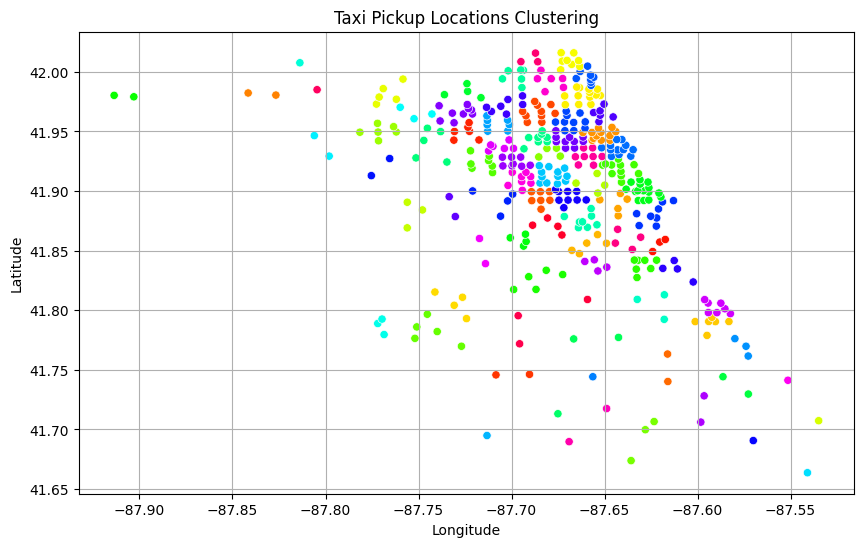

In [11]:

plt.figure(figsize=(10, 6))
sns.scatterplot(x='pickup_longitude', y='pickup_latitude', hue='cluster', palette=sns.color_palette("hsv", n_colors=len(pickup_counts['cluster'].unique())), data=pickup_counts, legend=None)

plt.title('Taxi Pickup Locations Clustering')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.grid(True)
plt.show()

In [12]:
# Determine Cluster Centers
cluster_centers = pickup_counts.groupby('cluster').mean()[['pickup_latitude', 'pickup_longitude']]

# Train Nearest Neighbors Model
nearest_neighbors_model = NearestNeighbors(n_neighbors=5, algorithm='ball_tree')
nearest_neighbors_model.fit(cluster_centers)

NearestNeighbors(algorithm='ball_tree')

In [ ]:
# # DBSCAN
# X = X.values

# dbscan = DBSCAN(eps=0.01, min_samples=10)  # eps value in degrees (about 1km at the equator), adjust based on your specific needs

# # Fit DBSCAN
# clusters = dbscan.fit_predict(X)

# # Add cluster labels back to the original DataFrame
# trips['cluster'] = clusters

# # Filtering out noise points
# trips_filtered = trips[trips['cluster'] != -1]

# plt.figure(figsize=(10, 6))
# plt.scatter(trips_filtered['pickup_longitude'], trips_filtered['pickup_latitude'], c=trips_filtered['cluster'], cmap='viridis', s=1)
# plt.title('DBSCAN Clustering of Taxi Pickup Locations')
# plt.xlabel('Longitude')
# plt.ylabel('Latitude')
# plt.colorbar(label='Cluster ID')
# plt.show()

In [13]:
# Function to get location details using Nominatim API
def get_location_details(lat, lon):
    url = f"https://nominatim.openstreetmap.org/reverse?lat={lat}&lon={lon}&format=json"
    response = requests.get(url)
    if response.status_code == 200:
        data = response.json()
        location_name = data.get('display_name')
        return pd.Series([location_name])
    else:
        return pd.Series(["Error", "Error"])

In [14]:
# Function to Recommend Pickup Locations
def recommend_pickup_locations(current_location, current_time, current_date, model, cluster_data, historical_data):
    # Finding the nearest clusters to the current location
    distances, indices = model.kneighbors([current_location])
    nearest_clusters = indices[0]

    filtered_data = historical_data[(historical_data['hour'] == current_time) & (historical_data['weekday'] == current_date)]

    # Ranking the nearest clusters based on their historical popularity
    ranked_clusters = filtered_data[filtered_data['cluster'].isin(nearest_clusters)].groupby('cluster').size().reset_index(name='count')
    ranked_clusters = ranked_clusters.sort_values(by='count', ascending=False).head(5)

    recommended_locations = ranked_clusters.merge(cluster_data, on='cluster')

    # Adding address and distance information
    recommended_locations[['address']] = recommended_locations.apply(lambda row: get_location_details(row['pickup_latitude'], row['pickup_longitude']), axis=1)
    recommended_locations['distance_km'] = recommended_locations.apply(lambda row: geodesic(current_location, (row['pickup_latitude'], row['pickup_longitude'])).kilometers, axis=1)

    return recommended_locations

In [15]:
def create_map(current_location, recommended_locations):
    # Create a map centered around the current location
    map = folium.Map(location=current_location, zoom_start=12)

    folium.Marker(
        current_location, 
        popup='Current Location', 
        icon=folium.Icon(color='red', icon='info-sign')
    ).add_to(map)

    for idx, row in recommended_locations.iterrows():
        popup_info = f"{idx+1}. {row['address']} (Distance: {row['distance_km']:.2f} km)"
        folium.Marker(
            [row['pickup_latitude'], row['pickup_longitude']],
            popup=popup_info,
            icon=folium.Icon(color='blue', icon='star')
        ).add_to(map)

    return map


In [18]:
# Example usage of the function
example_location = (41.947792, -87.683835)
example_time = 18  # 3 PM
example_date = 4  # Friday


recommended_pickups = recommend_pickup_locations(example_location, example_time, example_date, nearest_neighbors_model, cluster_centers, trips)
pickup_map = create_map(example_location, recommended_pickups)

display(recommended_pickups)
display(pickup_map)

/Library/Frameworks/Python.framework/Versions/3.8/lib/python3.8/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but NearestNeighbors was fitted with feature names
  warnings.warn(


,cluster,count,pickup_latitude,pickup_longitude,address,distance_km
0,34,96,41.943890,-87.685574,"3423, North Oakley Avenue, Bricktown, North Ce...",0.456720
1,3,57,41.966028,-87.685844,"Jefferson Pumping Station, West Eastwood Avenu...",2.032332
2,60,44,41.942424,-87.669446,"Lakeview YMCA, 3333, North Marshfield Avenue, ...",1.333895
3,50,35,41.958116,-87.667727,"4200, North Greenview Avenue, Lake View, Chica...",1.760343
4,19,5,41.932406,-87.678993,"2826-2838, North Clybourn Avenue, Bricktown, N...",1.755473
